## 1. Dataset overview

[Aquarium Combined](https://universe.roboflow.com/brad-dwyer/aquarium-combined) dataset consists of 638 images collected by Roboflow from two aquariums in the United States: The Henry Doorly Zoo in Omaha (October 16, 2020) and the National Aquarium in Baltimore (November 14, 2020).

Some basic information about dataset is available in "Health Check" tab [here](https://universe.roboflow.com/brad-dwyer/aquarium-combined/health). This tab already gives us great insight into the data without any effort, let's work through it step by step.

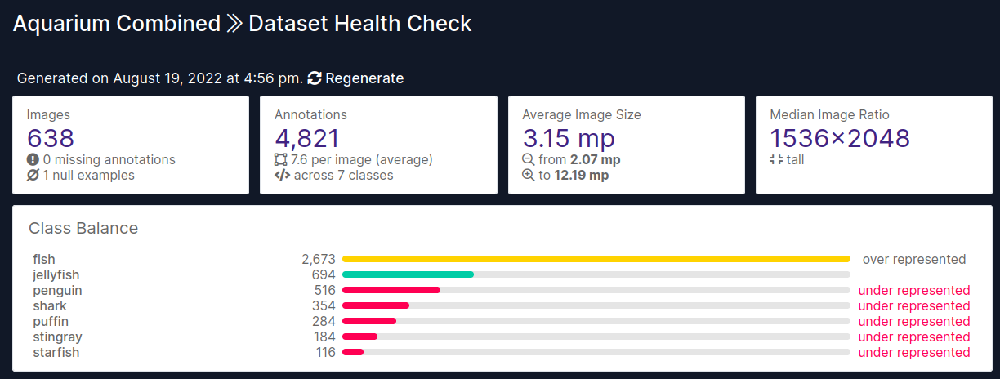

- Dataset consists of 638 images with 4821 annotations
- There is only one null image
  - Also called background image
  - Means that there are no objects present and therefore no annotations
  - It is often recommended to have some background images in training dataset in order to improve the model performance
  - Adding more background images might be good idea for "cheap" data-focused improvement when working on model development
- There are 7 classes representing 7 different aquatic animals
  - Fish
  - Jellyfish
  - Penguin
  - Shark
  - Puffin
  - Stingray
  - Starfish
- **Classes are highly imbalanced**
  - Fish examples are >55% of all annotations
  - This might be important when it comes to defining model objective and performance metrics


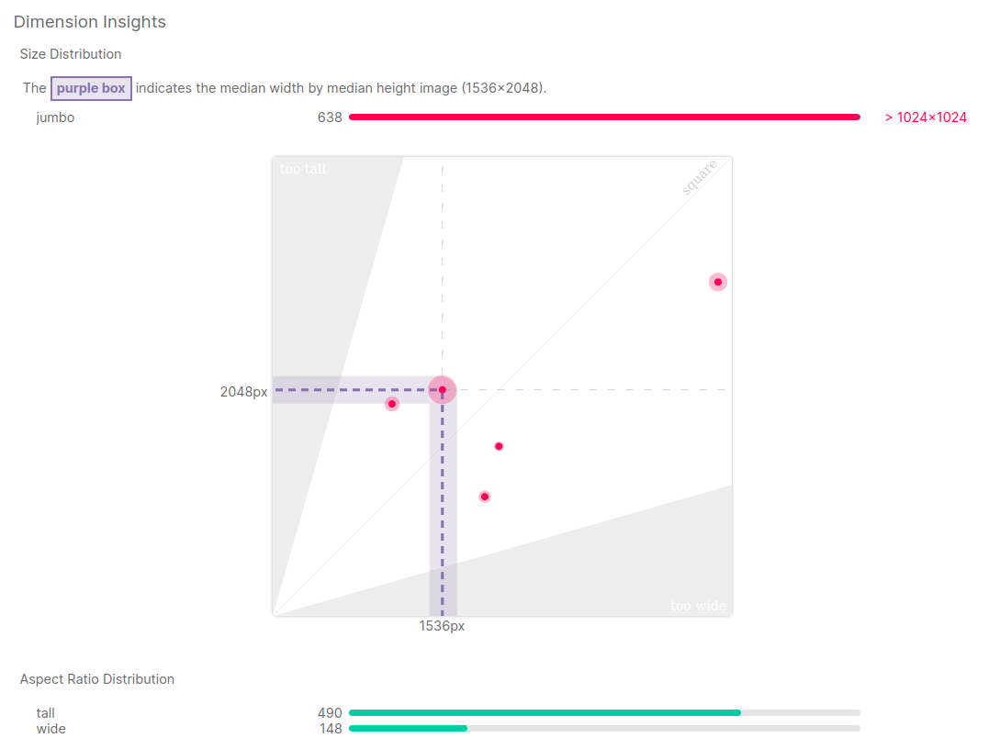

- Median image size is 1536 x 2048 (w x h)
  - These images are quite large
  - For reference - COCO dataset has images of size 640 x 480
  - Most likely these images will be downsized as part of preprocessing
- There are few different image sizes and **few different aspect ratios**
  - Different aspect ratios may be problematic for some model architectures
  - However, nowadays, many networks are dealing with it, e.g. using adaptive pooling

## 2. Annotation heatmaps

Roboflow dataset also readily provides annotation heatmaps - information about positions of annotated objects.

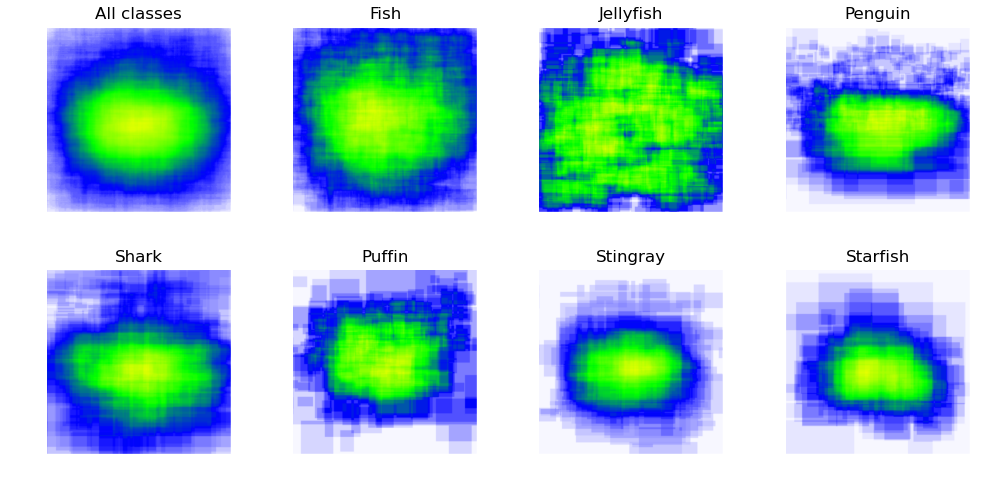

- Objects are mostly located in the center of the images
  - This pattern is visible in heatmaps for all of the classes
- Some classes (fish, jellyfish, shark) also have good coverage of regions at the edges of the pictures
- However, other classes lack annotations in some edge regions
  - Difference in distributions isn't huge, but it still might influence performance of the model for "out-of-distribution" examples (e.g. starfish located in the top right corner)
- It can be addressed with proper data augmentation
  - For example, mosaic augmentation used in YOLOv5 mitigates this issue


## 3. Data split
Dataset has predefined train/val/test split as shown below.

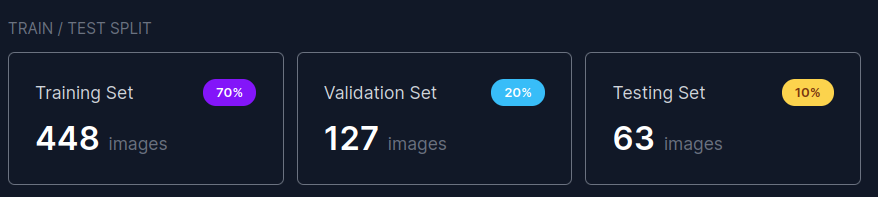

At the beginning of EDA process we investigated the class balance of the whole dataset.

**It is good idea to check if the class balance is maintained for the splits to asses that train/val/test sets are representative.**

Unfortunately Roboflow doesn't offer per-split class balance information. We will have to compute it ourselves.

## 4. Dataset download
Let's download dataset using Roboflow API. Data is available in various formats including YOLOv5/YOLOv7/YOLOv8, COCO and Pascal VOC. Currently we will use COCO format.

**You can obtain your link (Roboflow key) on the download page [here](https://universe.roboflow.com/brad-dwyer/aquarium-combined/dataset/5/download) (requires sign-up)**

In [ ]:
# %env YOUR_ROBOFLOW_KEY=

In [ ]:
import os

if "YOUR_ROBOFLOW_KEY" not in os.environ:
  raise RuntimeError("Set YOUR_ROBOFLOW_KEY environmental variable above!")

In [ ]:
!curl -L "https://universe.roboflow.com/ds/L0q2Ht5q1V?key=$YOUR_ROBOFLOW_KEY" > roboflow.zip; unzip -q roboflow.zip; rm roboflow.zip

## 5. Per-split class balance


For this part of EDA we will use COCO format to utilize [pycocotools](https://pypi.org/project/pycocotools/) library in order to compute number of annotations per class for each split.


In [ ]:
!pip install pycocotools -q

In [ ]:
from pycocotools.coco import COCO

def class_balance_statistics(coco):
  statistics = {}

  category_ids = coco.getCatIds()

  # "0" in annotation file is marked as "creatures" supercategory for all animals
  # It is unused and has no own annotations so we remove it for clarity 
  category_ids.remove(0)
  
  categories = coco.loadCats(category_ids)

  for cat in categories:
    annotations = coco.getAnnIds(catIds=[cat['id']])
    statistics[cat['name']] = len(annotations)

  return statistics

train_coco = COCO('/content/train/_annotations.coco.json')
valid_coco = COCO('/content/valid/_annotations.coco.json')
test_coco = COCO('/content/test/_annotations.coco.json')

train_stats = class_balance_statistics(train_coco)
valid_stats = class_balance_statistics(valid_coco)
test_stats = class_balance_statistics(test_coco)
combined_stats = {key: train_stats[key] + valid_stats[key] + test_stats[key] for key in train_stats.keys()}

In [ ]:
print('TRAIN')
print(train_stats)

print('\nVALID')
print(valid_stats)

print('\nTEST')
print(test_stats)

print('\nCOMBINED')
print(combined_stats)

TRAIN
{'fish': 1965, 'jellyfish': 385, 'penguin': 330, 'puffin': 175, 'shark': 259, 'starfish': 78, 'stingray': 136}

VALID
{'fish': 459, 'jellyfish': 155, 'penguin': 104, 'puffin': 74, 'shark': 57, 'starfish': 27, 'stingray': 33}

TEST
{'fish': 249, 'jellyfish': 154, 'penguin': 82, 'puffin': 35, 'shark': 38, 'starfish': 11, 'stingray': 15}

COMBINED
{'fish': 2673, 'jellyfish': 694, 'penguin': 516, 'puffin': 284, 'shark': 354, 'starfish': 116, 'stingray': 184}


First of all, we can confirm that sum of annotations for all splits (`combined_stats`) matches values reported by Roboflow Health Check.

Let's now normalize statistics for each split (to obtain percentage values, comparable between splits), and display them in a form of histogram.

In [ ]:
def normalize_statistics(stats_dict):
  total = sum(stats_dict.values())
  return {key: val/total for key, val in stats_dict.items()}

train_stats_norm = normalize_statistics(train_stats)
valid_stats_norm = normalize_statistics(valid_stats)
test_stats_norm = normalize_statistics(test_stats)
combined_stats_norm = normalize_statistics(combined_stats)

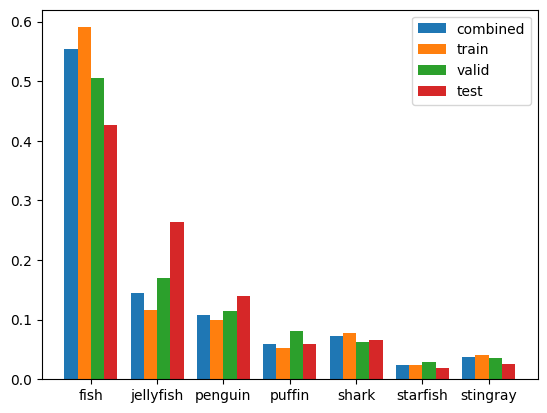

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

width = 0.2
xticks = list(train_stats_norm.keys())
x = np.arange(len(xticks))

plt.bar(x - 1.5 * width, combined_stats_norm.values(), width, label='combined')
plt.bar(x - 0.5 * width, train_stats_norm.values(), width, label='train')
plt.bar(x + 0.5 * width, valid_stats_norm.values(), width, label='valid')
plt.bar(x + 1.5 * width, test_stats_norm.values(), width, label='test')
plt.xticks(x, xticks)
plt.legend()
plt.show()

- Class balance is approximately maintained for all three splits
- The biggest discrepancy is seen between train and test splits for fish and jellyfish classes
- This might negatively influence performance of the model

<br/>

**Despite the concerns, we will still keep the predefined splits as this is not the crucial part of our focus/motivation**

It also might be challenging to derive better partitioning - we should take into account distributions of factors other than just class balance
- For example, we should consider background or environmental/lighting conditions (especially since the photos were taken in two different aquariums)
- We could analyze size and localization of bounding boxes for each split (we will also deliberately skip this in our study)

It is just worth remembering that "better" (more representative) data split might be one of the possible directions for data-focused model improvement

## 6. Data exploration with FiftyOne

Let's now explore images and their annotations to get better understanding of the task we are facing. The fastest way would be to use [Roboflow image browser](https://universe.roboflow.com/brad-dwyer/aquarium-combined/browse?queryText=&pageSize=50&startingIndex=0&browseQuery=true) for our dataset.


But let's use [FiftyOne](https://github.com/voxel51/fiftyone) instead as it is great tool for working with vision datasets. This way we will investigate more general approach, for datasets coming from sources other than Roboflow.

As a bonus: we can run FiftyOne directly in jupyter notebook (therefore also in Google Colab)

In [ ]:
!pip install fiftyone -q

In [ ]:
import fiftyone as fo

dataset = fo.Dataset('Aquarium Combined')

for split in ['train', 'valid', 'test']:
    dataset.add_dir(
        dataset_type=fo.types.COCODetectionDataset,
        data_path=f'/content/{split}',
        labels_path=f'/content/{split}/_annotations.coco.json',
        tags=split,
    )

# Uncomment if you want to launch the app
# session = fo.launch_app(dataset)

FiftyOne simplifies data exploration for vision datasets. With only few lines of code we can load basically any dataset (multiple data formats are supported) and get access to gallery, where we can filter images using various fields like class, data split or width/height. Labeled bounding boxes are overlaid on images and also contain additional metadata information.

Let's move to analysis now. First conclusions can be already drawn after looking at the set of random images for train/val/test splits

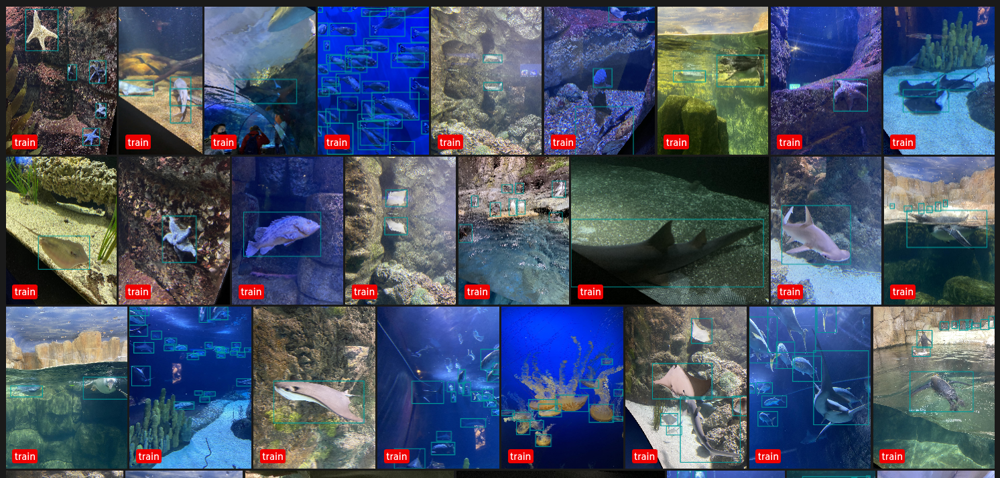

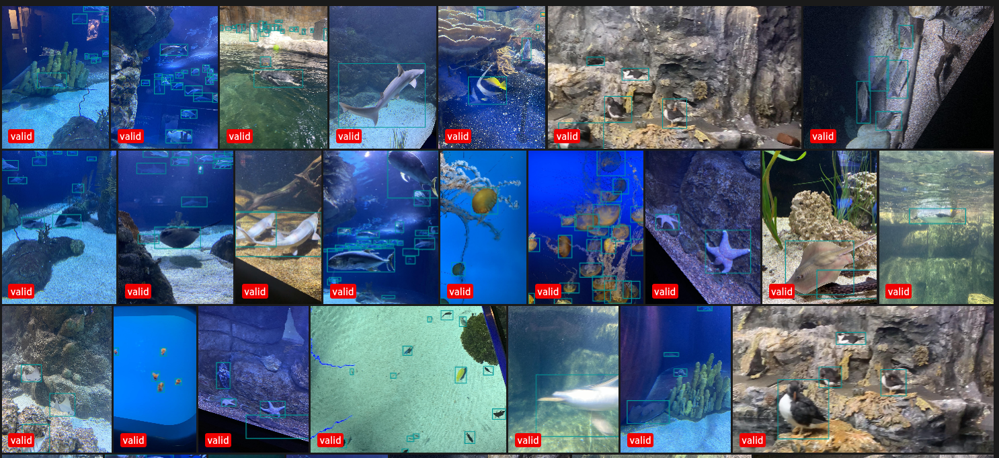

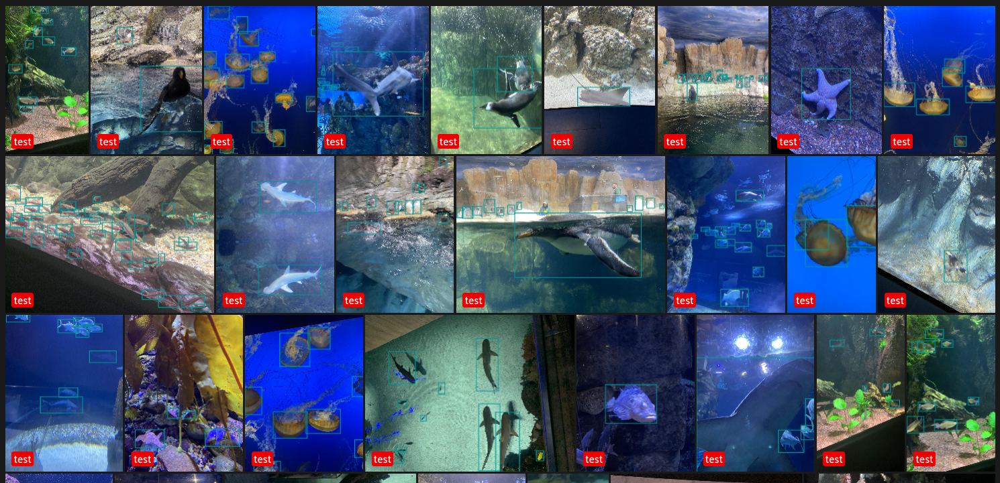

Immediately, we can see that photos are very diverse
- There are various backgrounds
    - The majority of photos were taken underwater, but there are also a few captured above the water's surface
    - Surprisingly few photos have only water (and no other objects) as a background
    - Most images contain formations such as plants, sand or rocks
- Photos were taken in different lighting conditions
- The number of objects and their distance from the photographer also vary
- Some images contain artifacts like
    - Reflections in the glass
    - Bubble
    - Slight blur

As a next step, let's see few examples for each of the classes.

FiftyOne also offers powerful API, which we can use to export/download annotated images and browse them in directories as a regular image files.

> Note #1: This operation may take around 10 minutes

> Note #2: Some of the images will be duplicated (downloaded into multiple classes directories) if they contain animals from multiple categories


In [ ]:
classes = ['fish', 'jellyfish', 'penguin', 'shark', 'puffin', 'stingray', 'starfish']
splits = ['train', 'valid', 'test']

for _class in classes:
    for split in splits:
        print(f'{_class} - {split}')
        view = dataset.match_tags(split).filter_labels('detections', fo.ViewField('label') == _class)

        output_dir = f'annotated_images/{_class}/{split}'
        view.draw_labels(output_dir, label_fields=['detections'],
                         show_object_attrs=False,
                         show_object_attr_names=False,
                         show_object_names=False,
                        )

As labeled images are now organized in directories we can explore each of the classes separately and understand their properties.

I'll use simple snippet to plot random example/examples from selected class and split.

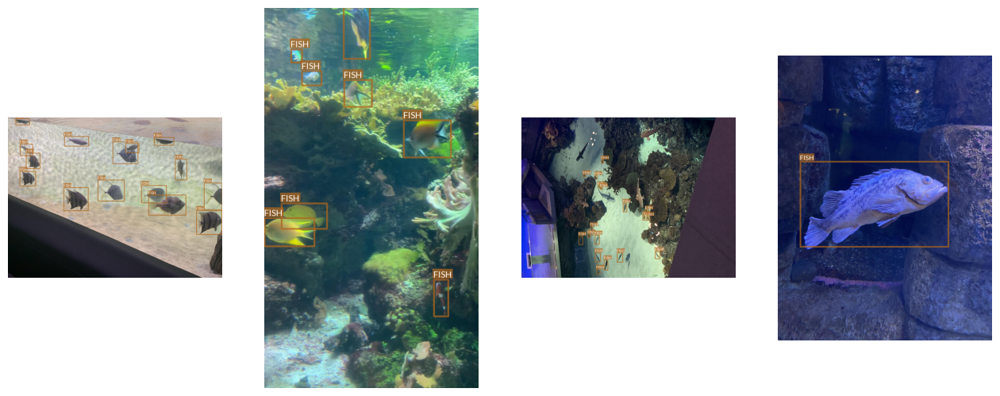

In [ ]:
import random
import os
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# SELECT SPLIT
split = 'train'
# split = 'valid'
# split = 'test'

# SELECT CLASS
_class = 'fish'
# _class = 'jellyfish'
# _class = 'penguin'
# _class = 'shark'
# _class = 'puffin'
# _class = 'stingray'
# _class = 'starfish'

# NUMBER OF IMAGES TO DRAW
nimgs = 4
nrows = 1
figsize = (16,7)

def draw(path, ax):
    img = np.asarray(Image.open(path))
    ax.imshow(img)
    ax.axis('off')

dir = f'annotated_images/{_class}/{split}'
files = os.listdir(dir)
full_paths = [os.path.join(dir, file) for file in files]
selected_paths = random.sample(full_paths, nimgs)

fig, ax = plt.subplots(nrows, nimgs, figsize=figsize)
if nimgs == 1:
  draw(selected_paths[0], ax)
else:
  for i, path in enumerate(selected_paths):
    draw(path, ax[i])

- This snippet is just a small demonstration, which might be useful as quick exploration tool for other datasets.

- Aquarium dataset, however, has images with various aspect ratios and contatins some very small objects, which are practically invisible on small plots created with a snippet.

-  **Therefore it is recommended to either browse downloaded annotated images by hand or use FiftyOne**

## 7. Image examples
Below section contains selected representative images for each class and some conclusions drawn during data exploration

### Fish
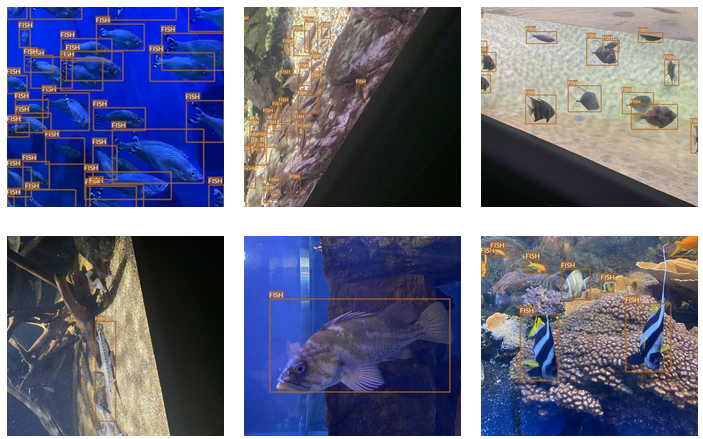

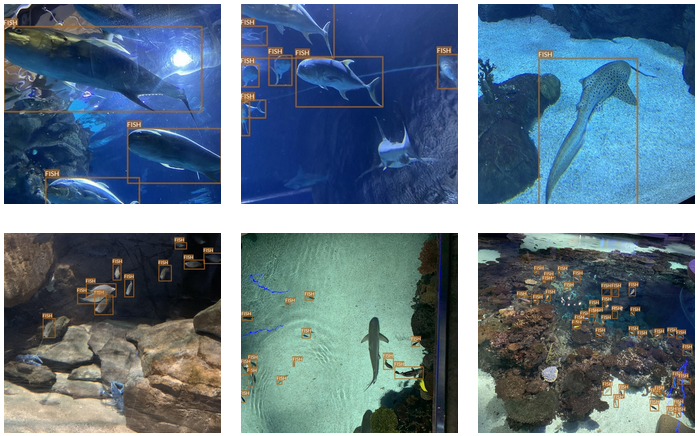

- "Fish" class in fact refers to multiple fish species
- These species have extreme differences between them in:
  - Coloration
  - Size
  - Body geometry
- Some species seem to be underrepresented
- Some small fishes are difficult even for a human to notice at the first glance
- These characteristics may pose some challenges for object detection task


### Jellyfish
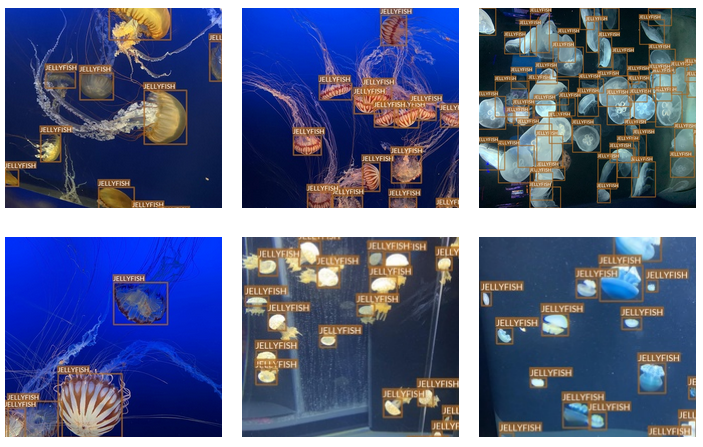

- "Jellyfish" class also refers to multiple jellyfish species
- Differences between species are, however, much smaller
- Most of the images are taken in "isolated conditions"
  - No other objects visible
  - Blue (water) background
- These features suggest that recognizing jellyfish can be relatively easy

### Penguin
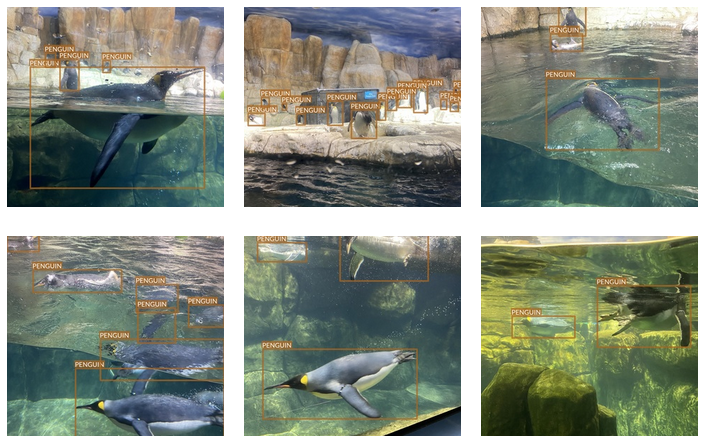

- There seem to be just two species of penguins
  - Their main difference is yellow patch on the neck
  - Apart from this, they look very similar
  - It's difficult to even tell them apart in many photos
- Photos are taken from different angles
  - Underwater
  - Above the water
  - At water level
- They also present different activities (and therefore contain animals in different poses) 
  - Standing or walking
  - Swimming
  - Diving or swimming underwater
- There are no other animals on penguins' images

### Shark
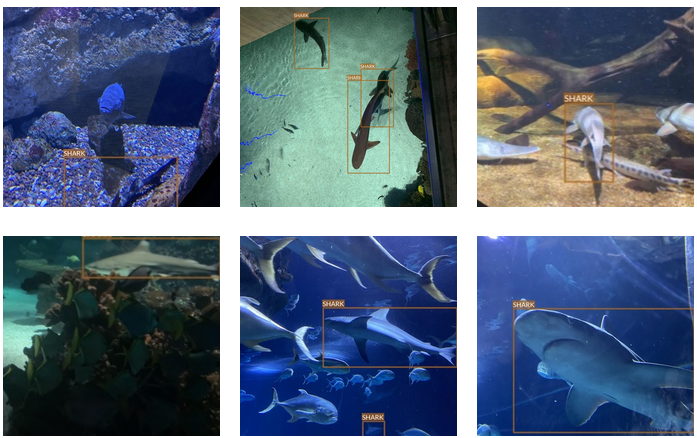

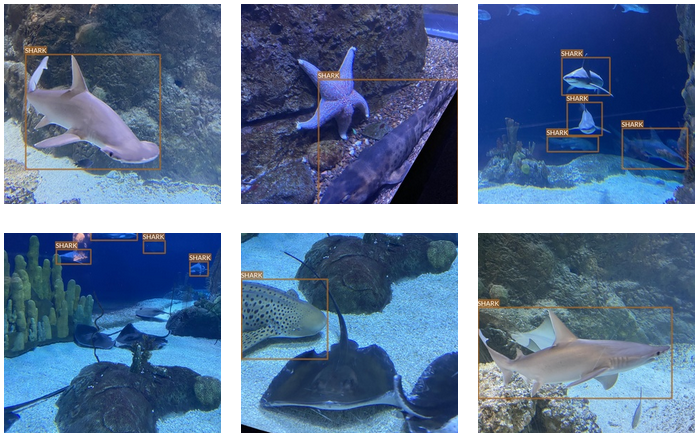

- Multple species
  - All of them seem to have some commonalities (e.g. dorsal fin)
  - But there also are very clear differences (e.g. head shape)
  - Some species are underrepresented
- Very wide range of conditions
  - Different lighting conditions
  - Various plants and decors
- Often photographed surrounded by other animals (mainly fish)

### Puffin
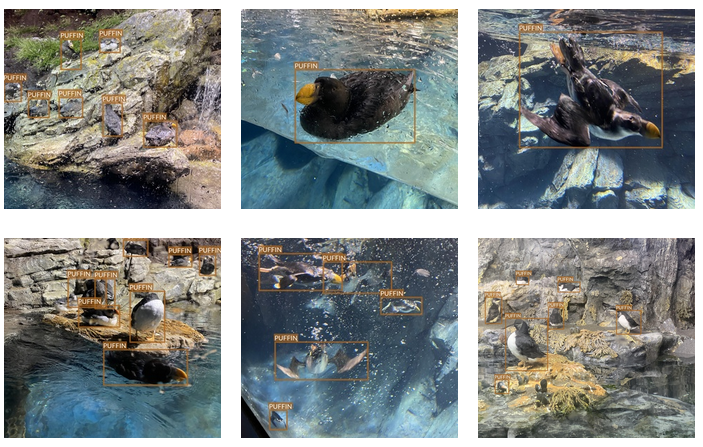

- At least two different puffin species
  - Different head colors
- Very similar set of camera angles and routines as in the penguin photos
- Quite a lot of photos have artifacts (drops of water on the window or underwater bubbles) that might degrade the performance of the detection algorithms

### Starfish
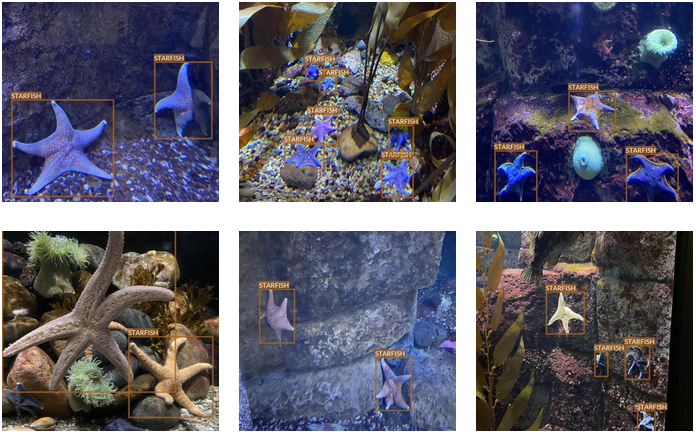

- Multiple species
  - Different coloration
  - Various sizes
  - But all species still have characteristic star-like shape
- Seems to be relatively easy to recognize
  - Unless photographed at an angle where the star shape is not visible

### Stingray
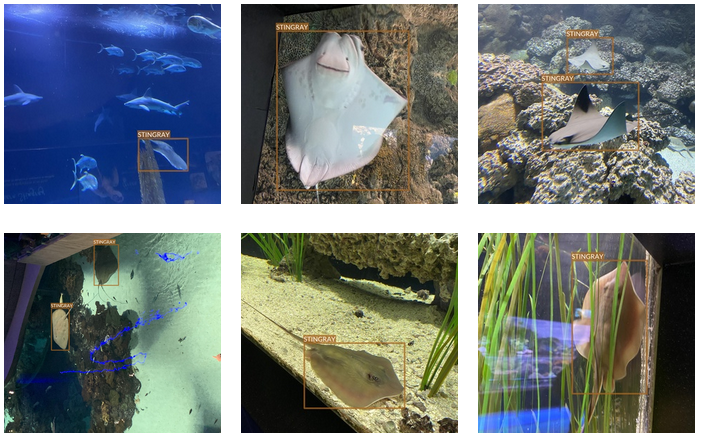

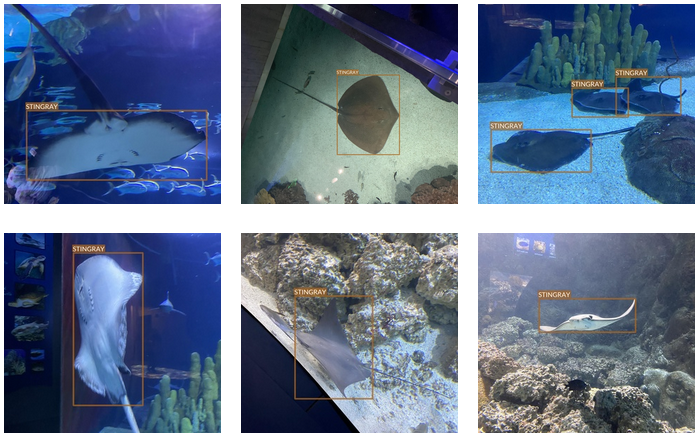

- At least two different species
  - Slight difference in color and shape
- Photographed swimming (with other animals - sharks and fish) or hovering over the bottom (alone or with other stingrays)
- There seem to be either very easy or quite difficult examples (in the context of object detection task)
  - Easy examples, where they are in the foreground
  - Difficult examples, where stingrays are in the background and it is difficult to distinguish them from shark or fish

### General conclusions
- There are two groups of relatively similar animals
  - Fish, sharks and (only in some images) stingrays
  - Penguins and puffins
- Animals from these groups might be misidentified, especially in adverse conditions (poor lighting, camera angle, being far from camera, specific pose)
- There are also classes, which are quite distinctive and not similar to the others
  - Jellyfish
  - Starfish

### Mislabeled image

During the analysis, it turned out that one of the images in the dataset is mislabeled.

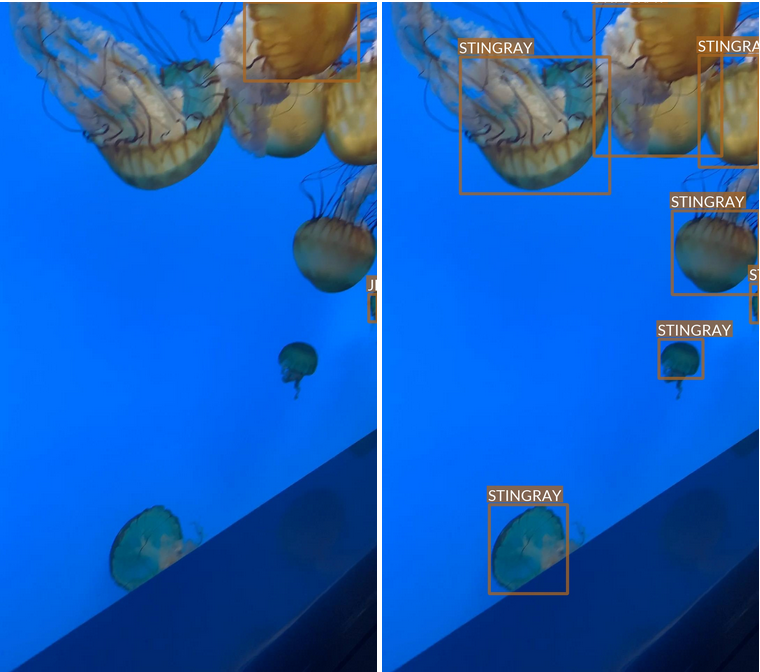

- There are two properly labeled jellyfish (image on the left)
- But another seven are mislabeled as stingrays (image on the right)

**It is important to either remove or fix these annotations before the model training!**

## 8. Task difficulty

As already mentioned, some of the photos are captured in adverse conditions, including
- Poor lighting
- Long distance between photographer and the object of interest
- Animal in specific pose or only partially visible
- Reflections on the glass
- Drops of water on the window
- Distortion on the water surface (for partially submerged objects)
- Underwater bubbles
- Motion blur


When working on machine learning task like object detection it is often common to use human performance as an initial benchmark. Exploring aquarium dataset we can notice that animals on some images are difficult even for human to detect at a first glance (and sometimes even after looking at it for a long time). A few such examples are presented below.

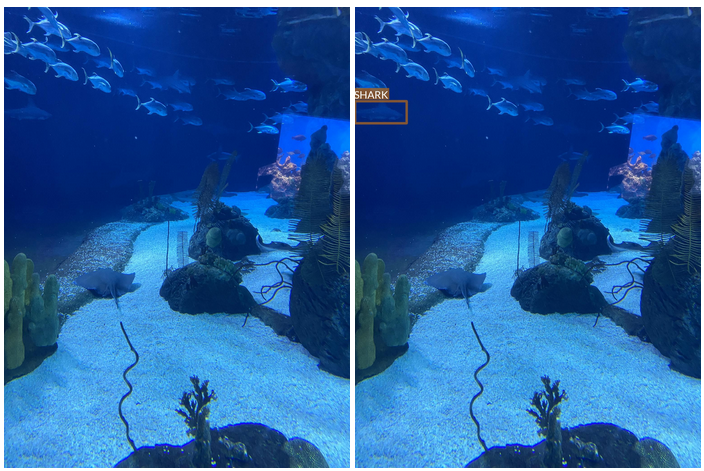

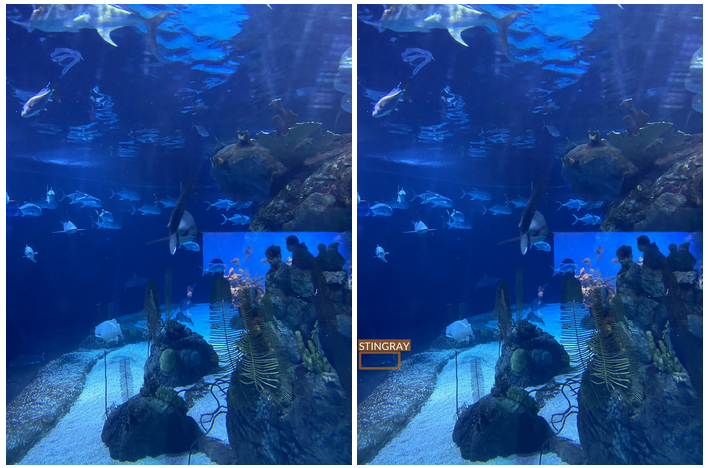

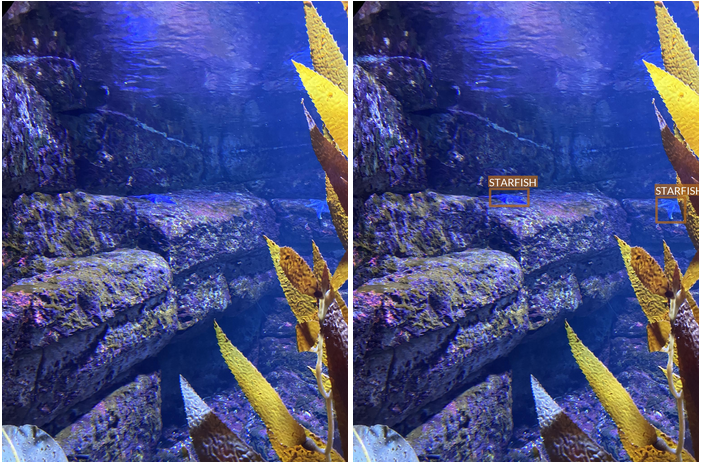

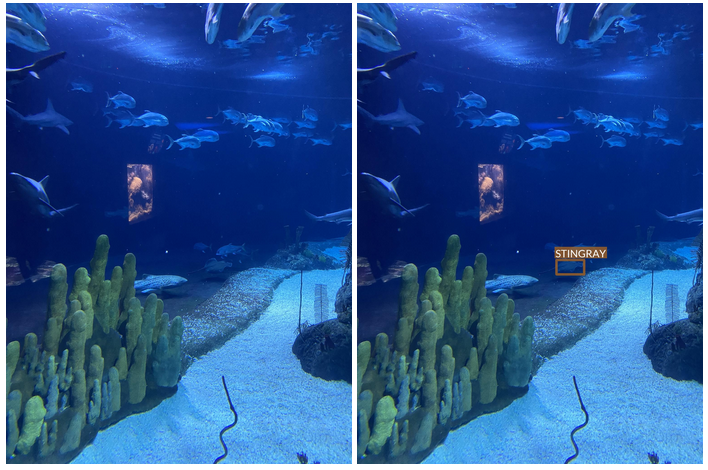


In contrast, there are also images where the conditions are favorable and the objects are clearly visible in the foreground.

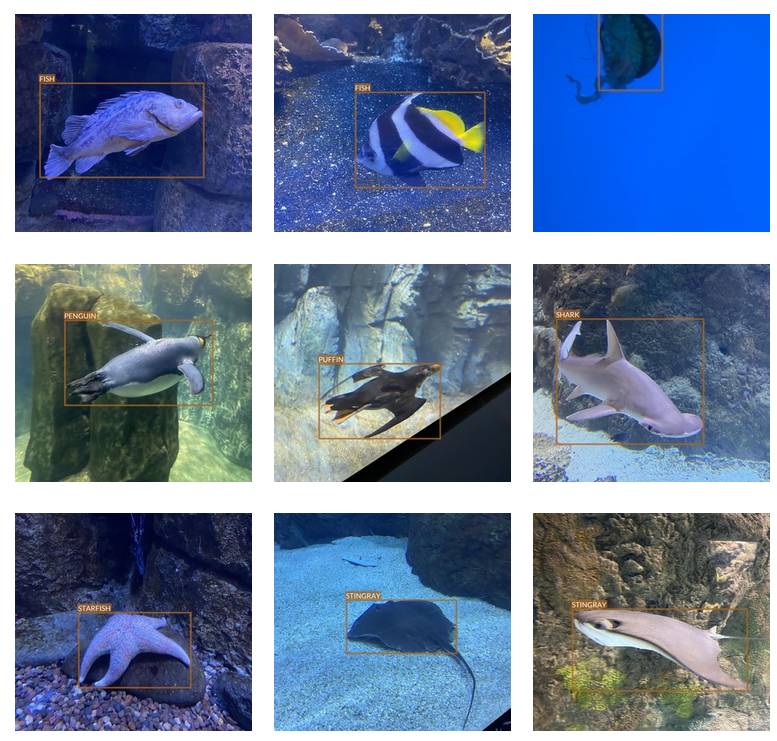

During model development it might be beneficial to not only look at general metrics but also analyze model results for particular images.

This approach allows to draw more specific conclusions like
- Noticing a gap in the data
- Understanding model limits (e.g. noticing that the model correctly detects all objects except very difficult ones)

## 9. Final remarks
There are few other things we could investigate during our analysis. Some interesting ideas are:
- Looking into bounding box (objects) sizes
- Evaluating the quality of annotations for each image
  - And re-annotation if necessary
- Marking "easy" and "difficult" photos
  - To monitor metrics for easy and difficult photos separately from joint metrics

**But let's end our data analysis here as we gained sufficient feel and understanding of the dataset. The data insights we have drawn here may be useful in the future when we run into problems when training detection models**